# Introduction

Uncover the factors that lead to employee attrition and explore important questions such as ‘show me a breakdown of distance from home by job role and attrition’ or ‘compare average monthly income by education and attrition’. This is a fictional data set created by IBM data scientists.

# We will use pycaret library

PyCaret is an open-source, low-code machine learning library in Python that automates machine learning workflows. It is an end-to-end machine learning and model management tool that speeds up the experiment cycle exponentially and makes you more productive.

In comparison with the other open-source machine learning libraries, PyCaret is an alternate low-code library that can be used to replace hundreds of lines of code with few lines only. This makes experiments exponentially fast and efficient. PyCaret is essentially a Python wrapper around several machine learning libraries and frameworks such as scikit-learn, XGBoost, LightGBM, CatBoost, Optuna, Hyperopt, Ray, and few more.

# Import Libraries

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


# Data Importing

In [2]:
data = pd.read_csv('/kaggle/input/ibm-hr-analytics-attrition-dataset/WA_Fn-UseC_-HR-Employee-Attrition.csv')
data

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8


# Discovering problem of the data

In [3]:
df=data.copy()
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8


We will  see if we have some problems in our data like null values....
But we will solve all this problem by pycaret library in modeling Phase it will clean the data and solve it's problem and molding the data

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

<Axes: title={'center': 'Count (Attrition)'}>

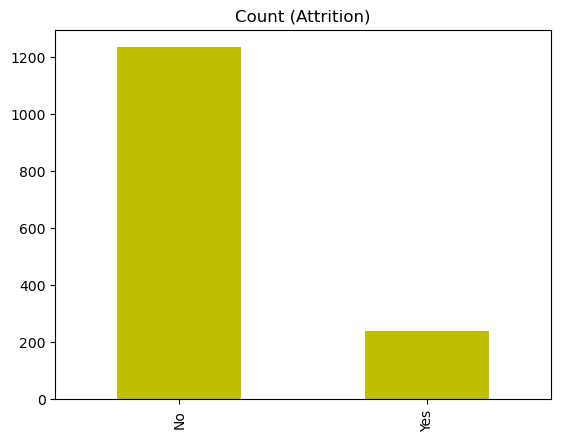

In [5]:
df['Attrition'].value_counts().plot(kind='bar', title='Count (Attrition)', color=['y', 'y'])

We have the problem of imbalance

In [6]:
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [7]:
df.duplicated().sum()

0

In [8]:
df['Education'].replace([1,2,3,4,5],["Below College","College"," Bachelor","Master","Doctor"],inplace=True)
df['EnvironmentSatisfaction'].replace([1,2,3,4,],["Low ","Medium"," High","Very High"],inplace=True)
df['JobInvolvement'].replace([1,2,3,4],["Low ","Medium"," High","Very High"],inplace=True)
df['JobSatisfaction'].replace([1,2,3,4],["Low ","Medium"," High","Very High"],inplace=True)
df['PerformanceRating'].replace([1,2,3,4],["Low ","Good"," Excellent"," Outstanding"],inplace=True)
df['RelationshipSatisfaction'].replace([1,2,3,4],["Low ","Medium"," High","Very High"],inplace=True)
df['WorkLifeBalance'].replace([1,2,3,4,],["Bad ","Good"," Better"," Best"],inplace=True)
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,College,Life Sciences,1,1,...,Low,80,0,8,0,Bad,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,Below College,Life Sciences,1,2,...,Very High,80,1,10,3,Better,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,College,Other,1,4,...,Medium,80,0,7,3,Better,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,Master,Life Sciences,1,5,...,High,80,0,8,3,Better,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,Below College,Medical,1,7,...,Very High,80,1,6,3,Better,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,College,Medical,1,2061,...,High,80,1,17,3,Better,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,Below College,Medical,1,2062,...,Low,80,1,9,5,Better,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,Bachelor,Life Sciences,1,2064,...,Medium,80,1,6,0,Better,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,Bachelor,Medical,1,2065,...,Very High,80,0,17,3,Good,9,6,0,8


# Data Visualization

In [9]:
pip install autoviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.5/18.5 MB 51.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 69.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 72.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 63.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.5/96.5 kB 8.9 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of panel to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 50.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 51.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 54.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.9/19.9 MB 50.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.9/19.9 

# Auto visualization | autoviz library

Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Shape of your Data Set loaded: (1470, 35)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    35 Predictors classified...
        4 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['EmployeeNumber', 'EmployeeCount', 'Over18', 'StandardHours']
22 numeric variables in data exceeds limit, taking top 30 variables
    List of variables selected: ['Age', 'DailyRate', 'Dist

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
Age,int64,0.000000,2,18.000000,60.000000,No issue
Attrition,object,0.000000,0,nan,nan,No issue
BusinessTravel,object,0.000000,0,nan,nan,No issue
DailyRate,int64,0.000000,60,102.000000,1499.000000,No issue
Department,object,0.000000,0,nan,nan,No issue
DistanceFromHome,int64,0.000000,1,1.000000,29.000000,No issue
Education,int64,0.000000,0,1.000000,5.000000,No issue
EducationField,object,0.000000,0,nan,nan,No issue
EmployeeCount,int64,0.000000,0,1.000000,1.000000,Zero-variance colum: drop before modeling process.
EmployeeNumber,int64,0.000000,100,1.000000,2068.000000,Possible ID colum: drop before modeling process.


Number of All Scatter Plots = 253


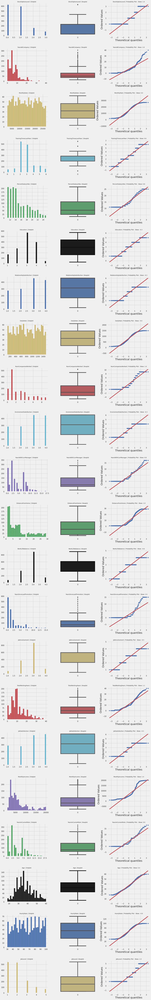

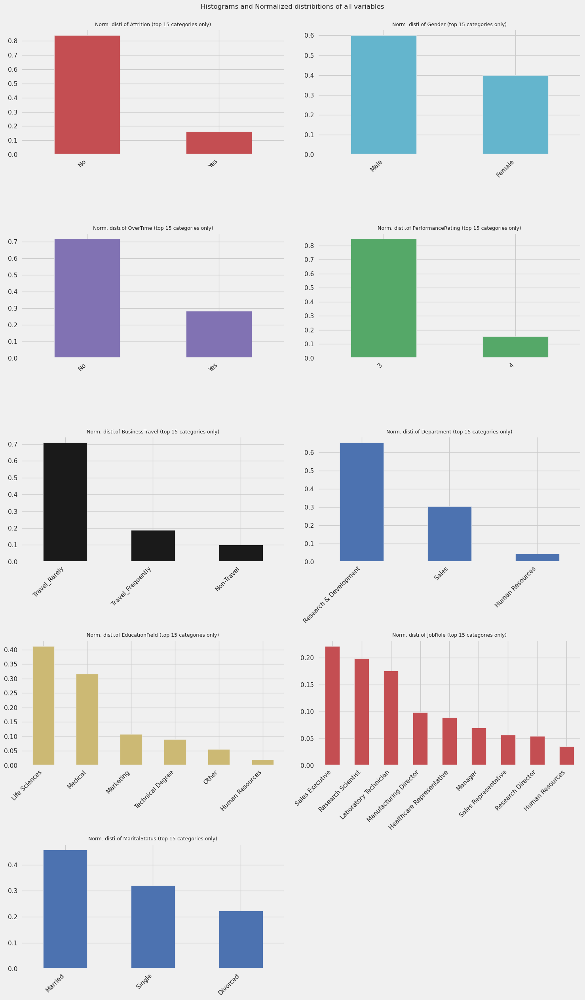

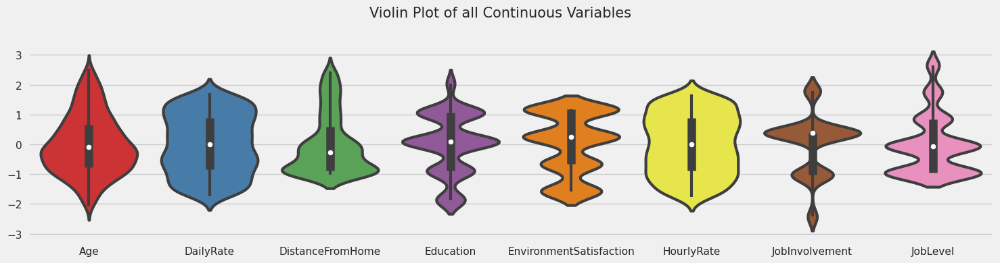

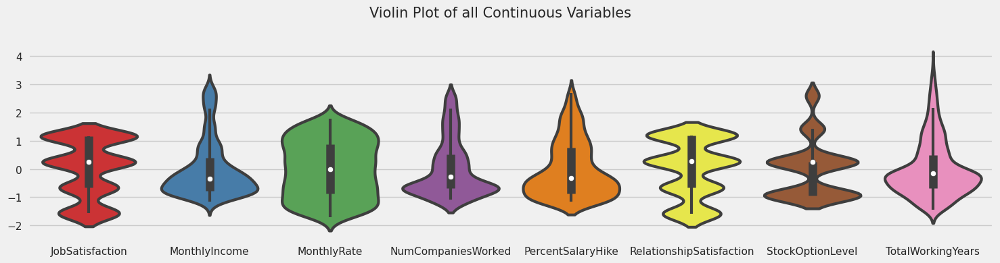

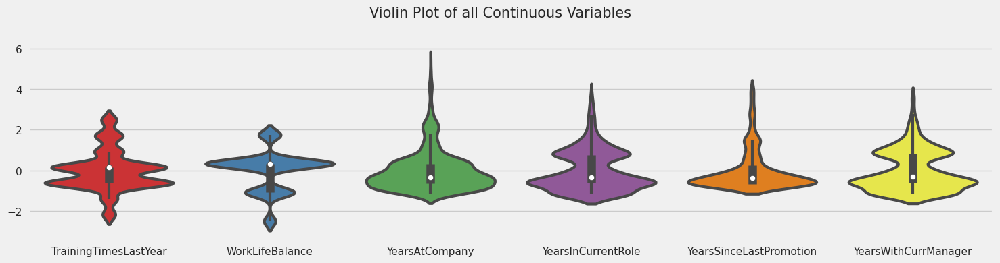

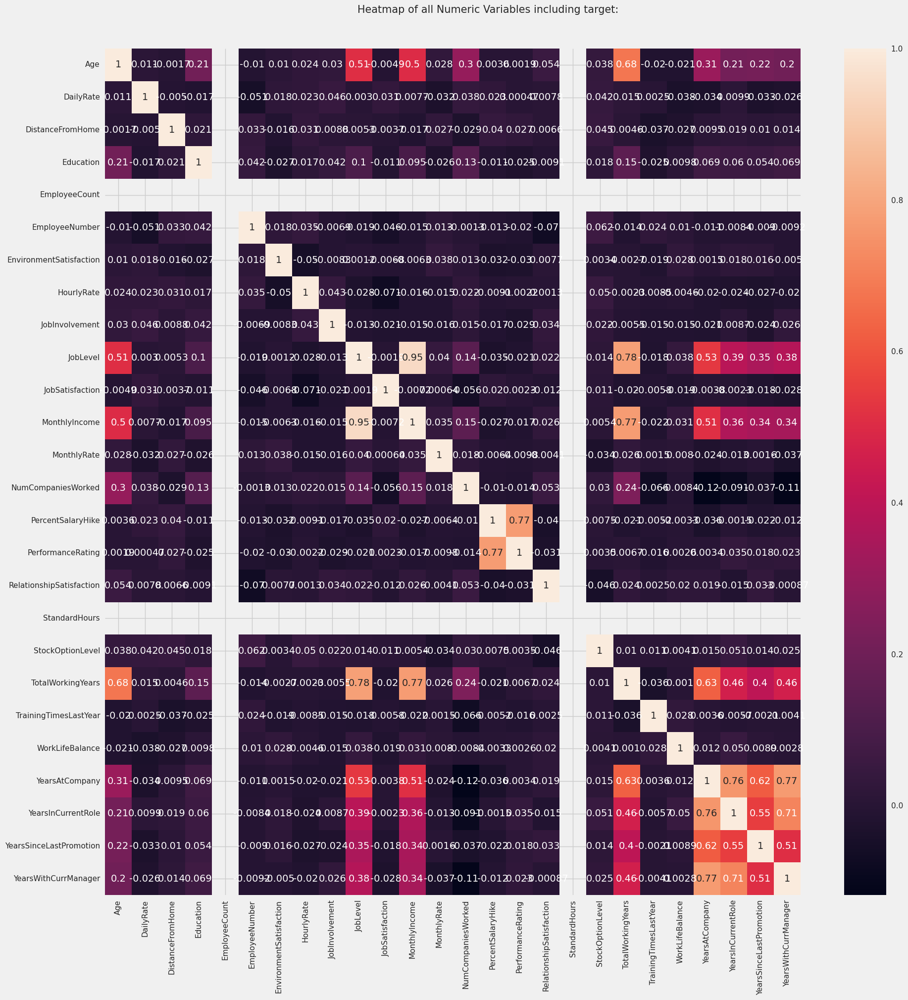

All Plots done
Time to run AutoViz = 168 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [10]:
from autoviz.AutoViz_Class import AutoViz_Class
%matplotlib inline

AV=AutoViz_Class()
viz=AV.AutoViz('/kaggle/input/ibm-hr-analytics-attrition-dataset/WA_Fn-UseC_-HR-Employee-Attrition.csv',sep=",")

# Insights I extracted from the data after the data visualization stage

only 16% of the employees have left the company

The percentage of males in the company is higher than females

The majority of employee are between 28 - 36 years old, while the range of age are 18 - 60 the Company seems to be highly depended on segment of employees younger than 40 years old.

The employee whose status labeled single have clear indication to leave the company

we can see that ‘sales executive’, ‘sales representative’, and ‘lab technician’ are more likely to leave compared to other roles.

employees who travelled rarely had the highest attrition level, whereas the employees who were not required to travel had the least chance of attrition.

the employee of Bachelor degree tends to leave company than the people have any other degrees

the education field Life Sciences had the highest precentage of attrition, followed by Medical and Marketing.

we can see more employees tend to leave with less than 2 years with the current managers

Employees with 1 year experience has the highest percentage to leave


As the level of education increases , average monthly income increases

single employees have low MonthlyIncome compared by other, so that's why they leave more

# Encoding the string columns

In [11]:
df.describe(include = "object")

,Attrition,BusinessTravel,Department,Education,EducationField,EnvironmentSatisfaction,Gender,JobInvolvement,JobRole,JobSatisfaction,MaritalStatus,Over18,OverTime,PerformanceRating,RelationshipSatisfaction,WorkLifeBalance
count,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,5,6,4,2,4,9,4,3,1,2,2,4,4
top,No,Travel_Rarely,Research & Development,Bachelor,Life Sciences,High,Male,High,Sales Executive,Very High,Married,Y,No,Excellent,High,Better
freq,1233,1043,961,572,606,453,882,868,326,459,673,1470,1054,1244,459,893


In [12]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

In [13]:
cols = ['Attrition', 'BusinessTravel', 'Department','EducationField','Education','EnvironmentSatisfaction','Gender','JobInvolvement','JobRole','JobSatisfaction','MaritalStatus','Over18','OverTime','PerformanceRating','RelationshipSatisfaction','WorkLifeBalance']

df[cols] = df[cols].apply(LabelEncoder().fit_transform)

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype
---  ------                    --------------  -----
 0   Age                       1470 non-null   int64
 1   Attrition                 1470 non-null   int64
 2   BusinessTravel            1470 non-null   int64
 3   DailyRate                 1470 non-null   int64
 4   Department                1470 non-null   int64
 5   DistanceFromHome          1470 non-null   int64
 6   Education                 1470 non-null   int64
 7   EducationField            1470 non-null   int64
 8   EmployeeCount             1470 non-null   int64
 9   EmployeeNumber            1470 non-null   int64
 10  EnvironmentSatisfaction   1470 non-null   int64
 11  Gender                    1470 non-null   int64
 12  HourlyRate                1470 non-null   int64
 13  JobInvolvement            1470 non-null   int64
 14  JobLevel                  1470 non-null 

# Auto  preprocessing and ML modeling pycaret library

In [15]:
pip install pycaret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 484.4/484.4 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.4/153.4 kB 14.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... - \ done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 13.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.8/106.8 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.4/46.4 kB 3.6 MB/s eta 0:00:00
  Installing build dependencies ... - \ | / - \ | / - done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.0/17.0 MB 51.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 35.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 77.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 185.2/185.2

In [16]:
from pycaret.classification import *

In [17]:
s = setup(df, target = 'Attrition', session_id = 123,fix_imbalance=True)
set_config('fix_imbalance',True)

,Description,Value
0,Session id,123
1,Target,Attrition
2,Target type,Binary
3,Original data shape,"(1470, 35)"
4,Transformed data shape,"(2167, 35)"
5,Transformed train set shape,"(1726, 35)"
6,Transformed test set shape,"(441, 35)"
7,Numeric features,34
8,Preprocess,True
9,Imputation type,simple


In [18]:
best=compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
catboost,CatBoost Classifier,0.8630,0.8050,0.2967,0.6770,0.4086,0.3451,0.3844,5.5780
et,Extra Trees Classifier,0.8601,0.7895,0.2173,0.7538,0.3327,0.2798,0.3504,0.8720
xgboost,Extreme Gradient Boosting,0.8571,0.7561,0.3029,0.6252,0.4006,0.3323,0.3632,0.8170
ada,Ada Boost Classifier,0.8513,0.8014,0.4471,0.5539,0.4893,0.4043,0.4104,0.7060
gbc,Gradient Boosting Classifier,0.8494,0.7776,0.3136,0.5718,0.4000,0.3225,0.3441,1.3430
rf,Random Forest Classifier,0.8474,0.7814,0.1938,0.5833,0.2870,0.2265,0.2709,1.0620
lightgbm,Light Gradient Boosting Machine,0.8445,0.7538,0.2176,0.5936,0.3147,0.2458,0.2883,0.8650
dummy,Dummy Classifier,0.8387,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.1370
dt,Decision Tree Classifier,0.7522,0.5900,0.3504,0.2846,0.3121,0.1639,0.1661,0.1510
qda,Quadratic Discriminant Analysis,0.7425,0.6507,0.3265,0.2651,0.2898,0.1363,0.1383,0.2620


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

In [19]:
evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [20]:
save_model(best, 'best_pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=FastMemory(location=/tmp/joblib),
          steps=[('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['Age', 'BusinessTravel',
                                              'DailyRate', 'Department',
                                              'DistanceFromHome', 'Education',
                                              'EducationField', 'EmployeeCount',
                                              'EmployeeNumber',
                                              'EnvironmentSatisfaction',
                                              'Gender', 'HourlyRate',
                                              'JobInvolvement', 'JobLevel',
                                              'JobRole', 'JobSatisfaction'...
                                                               keep_empty_features=False,
                                                               missing_values=nan,
                     

If you found it helpful, do upvote

Feel free to comment

I would love to have suggestions.